# Activation Grids

Julia Artigas Rodriguez

In [1]:
import torch
import torch.nn as nn
from torch.autograd import Variable
from torchvision import transforms, utils
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter, ImageChops
import torchvision.transforms as transforms
from google.colab import files
import numpy as np

import matplotlib.pyplot as plt
from IPython import display
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import torchvision.models as models
from torch.optim import lr_scheduler
import time
import os
import copy

import torchvision
!pip install --quiet lightning-bolts
!pip install --quiet git+https://github.com/greentfrapp/lucent.git
from lucent.optvis import render, param, transform, objectives
from pl_bolts.models.self_supervised import SimCLR # per carregar el model auto-supervisat (SimCLR)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from torchsummary import summary
from lucent.misc.channel_reducer import ChannelReducer

import numpy as np
from skimage.feature import local_binary_pattern
from PIL import Image


     |████████████████████████████████| 316 kB 5.2 MB/s 
     |████████████████████████████████| 585 kB 47.2 MB/s 
     |████████████████████████████████| 418 kB 47.4 MB/s 
     |████████████████████████████████| 140 kB 74.6 MB/s 
     |████████████████████████████████| 596 kB 45.4 MB/s 
     |████████████████████████████████| 1.1 MB 52.8 MB/s 
     |████████████████████████████████| 94 kB 3.9 MB/s 
     |████████████████████████████████| 144 kB 46.0 MB/s 
     |████████████████████████████████| 271 kB 61.5 MB/s 
     |████████████████████████████████| 225 kB 5.0 MB/s 
     |████████████████████████████████| 297 kB 47.4 MB/s 
     |████████████████████████████████| 297 kB 55.7 MB/s 
     |████████████████████████████████| 297 kB 60.0 MB/s 
     |████████████████████████████████| 296 kB 54.3 MB/s 
     |████████████████████████████████| 296 kB 56.2 MB/s 
     |████████████████████████████████| 280 kB 52.2 MB/s 
     |████████████████████████████████| 280 kB 56.8 MB/s 
     |████████████

In [2]:
resnet50 = torchvision.models.resnet50(pretrained = True, progress = True)
weight_path = 'https://pl-bolts-weights.s3.us-east-2.amazonaws.com/simclr/bolts_simclr_imagenet/simclr_imagenet.ckpt'
resnet50_ss = SimCLR.load_from_checkpoint(weight_path, strict=False)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
resnet50.to(device).eval()
resnet50_ss.to(device).eval()


Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

Downloading: "https://pl-bolts-weights.s3.us-east-2.amazonaws.com/simclr/bolts_simclr_imagenet/simclr_imagenet.ckpt" to /root/.cache/torch/hub/checkpoints/simclr_imagenet.ckpt


  0%|          | 0.00/229M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/core/saving.py:218: UserWarning: Found keys that are not in the model state dict but in the checkpoint: ['non_linear_evaluator.block_forward.2.weight', 'non_linear_evaluator.block_forward.2.bias']
  f"Found keys that are not in the model state dict but in the checkpoint: {keys.unexpected_keys}"


SimCLR(
  (encoder): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (

In [3]:
@torch.no_grad()
def get_layer(model, layer, X):
    hook = render.ModuleHook(getattr(model, layer))
    model(X)
    hook.close()
    return hook.features


@objectives.wrap_objective()
def dot_compare(layer, acts, batch=1):
    def inner(T):
        pred = T(layer)[batch]
        return -(pred * acts).sum(dim=0, keepdims=True).mean()

    return inner
    
def render_activation_grid_less_naive(
    img,
    model,
    layer,
    cell_image_size=60,
    n_groups=6,
    n_steps=1024,
    batch_size=64,
):
    # First wee need, to normalize and resize the image
    img = torch.tensor(np.transpose(img, [2, 0, 1])).to(device)
    #normalize = (
    #    transform.preprocess_inceptionv1()
    #    if model._get_name() == "InceptionV1"
    #    else transform.normalize()
    #)
    #transforms = transform.standard_transforms.copy() + [
    #    normalize,
    #    torch.nn.Upsample(size=224, mode="bilinear", align_corners=True),
    #]
    #transforms_f = transform.compose(transforms)
    # shape: (1, 3, original height of img, original width of img)
    img = img.unsqueeze(0)
    # shape: (1, 3, 224, 224)
    #img = transforms_f(img)

    # Here we compute the activations of the layer `layer` using `img` as input
    # shape: (layer_channels, layer_height, layer_width), the shape depends on the layer
    acts = get_layer(model, layer, img)[0]
    # shape: (layer_height, layer_width, layer_channels)
    acts = acts.permute(1, 2, 0)
    # shape: (layer_height*layer_width, layer_channels)
    acts = acts.view(-1, acts.shape[-1])
    acts_np = acts.cpu().numpy()
    nb_cells = acts.shape[0]

    # negative matrix factorization `NMF` is used to reduce the number
    # of channels to n_groups. This will be used as the following.
    # Each cell image in the grid is decomposed into a sum of
    # (n_groups+1) images. First, each cell has its own set of parameters
    #  this is what is called `cells_params` (see below). At the same time, we have
    # a of group of images of size 'n_groups', which also have their own image parametrized
    # by `groups_params`. The resulting image for a given cell in the grid
    # is the sum of its own image (parametrized by `cells_params`)
    # plus a weighted sum of the images of the group. Each each image from the group
    # is weighted by `groups[cell_index, group_idx]`. Basically, this is a way of having
    # the possibility to make cells with similar activations have a similar image, because
    # cells with similar activations will have a similar weighting for the elements
    # of the group.
    if n_groups > 0:
        reducer = ChannelReducer(n_groups, "NMF")
        groups = reducer.fit_transform(acts_np)
        groups /= groups.max(0)
    else:
        groups = np.zeros([])
    # shape: (layer_height*layer_width, n_groups)
    groups = torch.from_numpy(groups)

    # Parametrization of the images of the groups (we have 'n_groups' groups)
    groups_params, groups_image_f = param.fft_image(
        [n_groups, 3, cell_image_size, cell_image_size]
    )
    # Parametrization of the images of each cell in the grid (we have 'layer_height*layer_width' cells)
    cells_params, cells_image_f = param.fft_image(
        [nb_cells, 3, cell_image_size, cell_image_size]
    )

    # First, we need to construct the images of the grid
    # from the parameterizations

    def image_f():
        groups_images = groups_image_f()
        cells_images = cells_image_f()
        X = []
        for i in range(nb_cells):
            x = 0.7 * cells_images[i] + 0.5 * sum(
                groups[i, j] * groups_images[j] for j in range(n_groups)
            )
            X.append(x)
        X = torch.stack(X)
        return X

    # make sure the images are between 0 and 1
    image_f = param.to_valid_rgb(image_f, decorrelate=True)

    # After constructing the cells images, we sample randomly a mini-batch of cells
    # from the grid. This is to prevent memory overflow, especially if the grid
    # is large.
    def sample(image_f, batch_size):
        def f():
            X = image_f()
            inds = torch.randint(0, len(X), size=(batch_size,))
            inputs = X[inds]
            # HACK to store indices of the mini-batch, because we need them
            # in objective func. Might be better ways to do that
            sample.inds = inds
            return inputs

        return f

    image_f_sampled = sample(image_f, batch_size=batch_size)

    # Now, we define the objective function

    def objective_func(model):
        # shape: (batch_size, layer_channels, cell_layer_height, cell_layer_width)
        pred = model(layer)
        # use the sampled indices from `sample` to get the corresponding targets
        target = acts[sample.inds].to(pred.device)
        # shape: (batch_size, layer_channels, 1, 1)
        target = target.view(target.shape[0], target.shape[1], 1, 1)
        dot = (pred * target).sum(dim=1).mean()
        return -dot

    obj = objectives.Objective(objective_func)

    def param_f():
        # We optimize the parametrizations of both the groups and the cells
        params = list(groups_params) + list(cells_params)
        return params, image_f_sampled

    results = render.render_vis(
        model,
        obj,
        param_f,
        thresholds=(n_steps,),
        show_image=False,
        progress=True,
        fixed_image_size=cell_image_size,
    )
    # shape: (layer_height*layer_width, 3, grid_image_size, grid_image_size)
    imgs = image_f()
    imgs = imgs.cpu().data
    imgs = imgs[:, :, 2:-2, 2:-2]
    # turn imgs into a a grid
    grid = torchvision.utils.make_grid(imgs, nrow=int(np.sqrt(nb_cells)), padding=0)
    grid = grid.permute(1, 2, 0)
    grid = grid.numpy()
    render.show(grid)
    return imgs

(224, 224, 3)



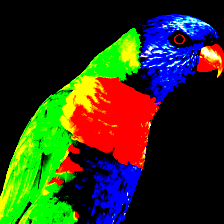

In [6]:
import torchvision.transforms as T
from lucent.misc.io import show

torch.cuda.empty_cache()
img = Image.open("/content/drive/MyDrive/Colab Notebooks/n01820546_1591.JPEG")

preprocess = T.Compose([
   T.Resize(224),
   T.CenterCrop(224),
   T.ToTensor(),
   T.Normalize(mean=[0.485, 0.456, 0.406],
              std=[0.229, 0.224, 0.225])
   ])

img = preprocess(img)
img.cpu().detach()
img=np.array(img, np.float32)
img = img.transpose((1, 2, 0))
print(img.shape)

show(img)


/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:12:05<00:00,  4.22s/it]



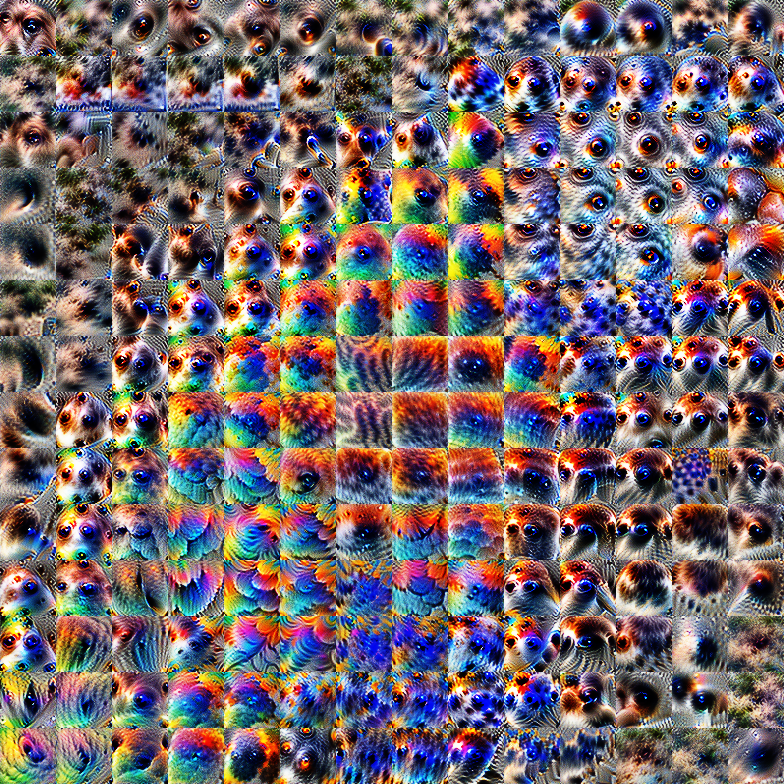

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer3', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
100%|██████████| 1024/1024 [1:14:32<00:00,  4.37s/it]



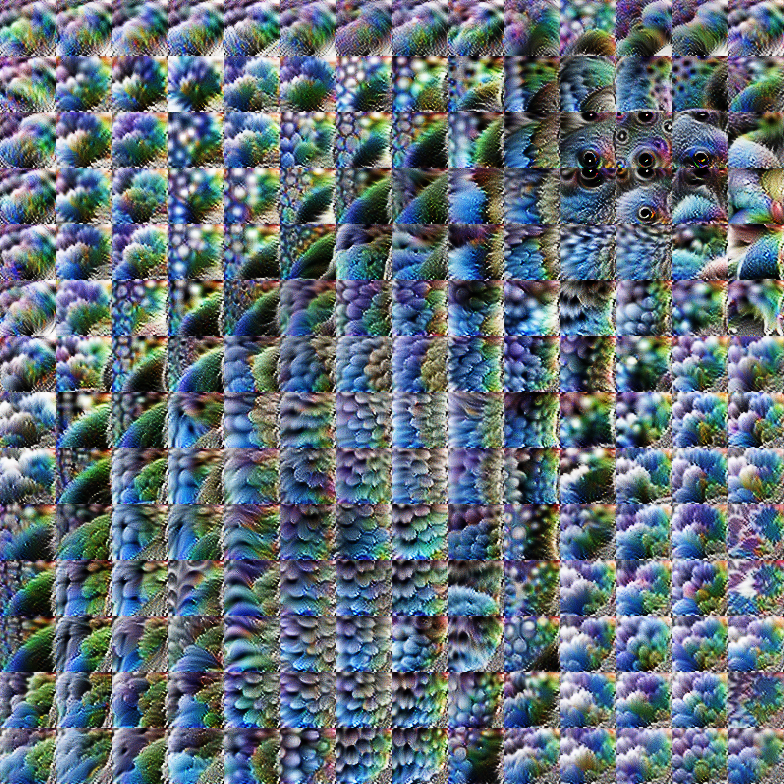

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer3', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:08:25<00:00,  4.01s/it]



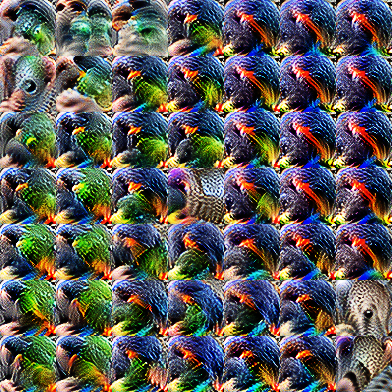

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer4', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
100%|██████████| 1024/1024 [1:10:20<00:00,  4.12s/it]



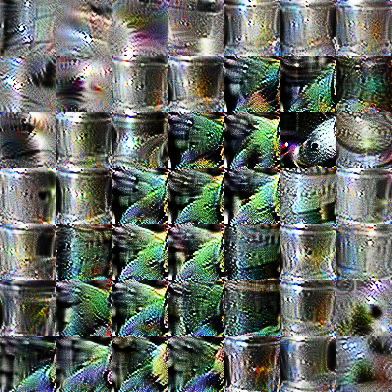

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer4', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
  0%|          | 1/1024 [00:45<12:55:00, 45.45s/it]


Interrupted optimization at step 2.



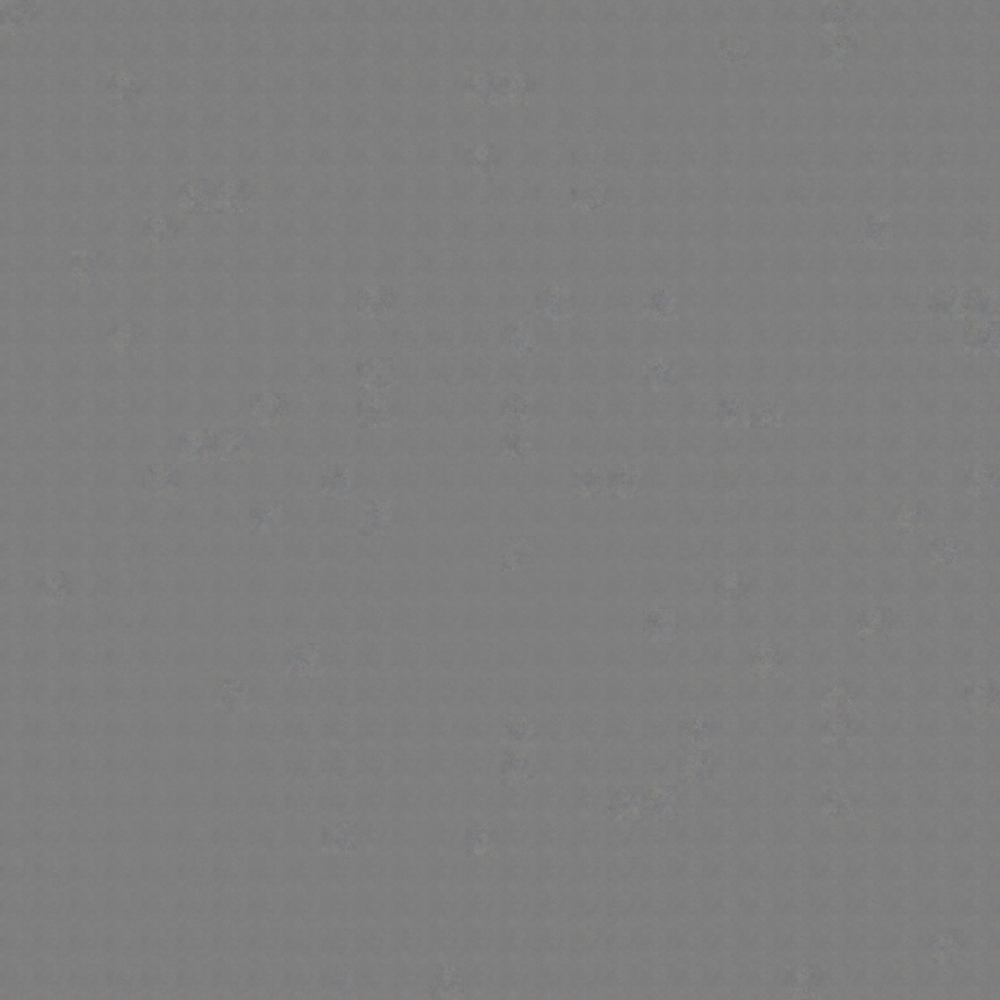

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer2', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
  0%|          | 1/1024 [00:41<11:42:36, 41.21s/it]


Interrupted optimization at step 2.



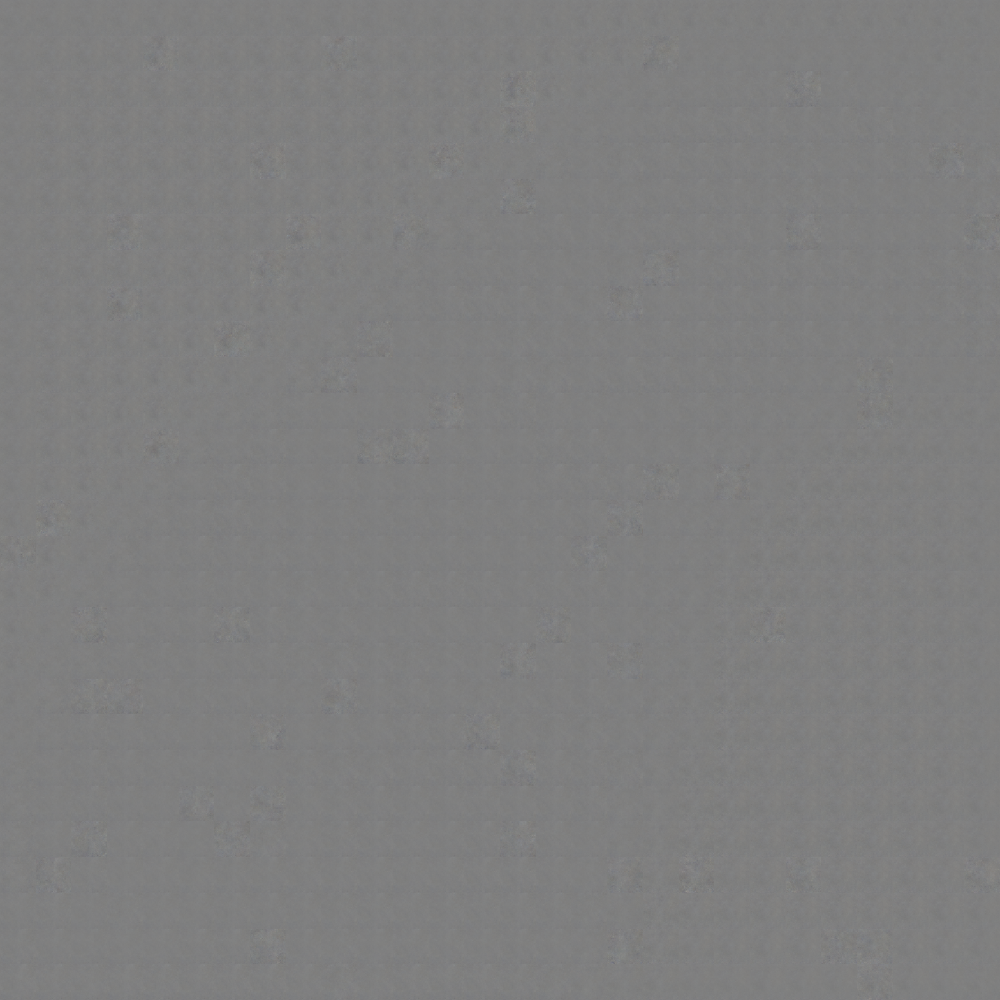

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer2', cell_image_size=60, n_steps=1024)

(224, 224, 3)



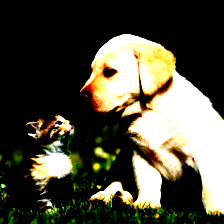

In [7]:
torch.cuda.empty_cache()

!wget -qnc https://i.pinimg.com/originals/44/d9/8c/44d98cccb725fd3a80c0446b9b2e646d.jpg

img = Image.open("44d98cccb725fd3a80c0446b9b2e646d.jpg")
preprocess = T.Compose([
   T.Resize(224),
   T.CenterCrop(224),
   T.ToTensor(),
   T.Normalize(mean=[0.485, 0.456, 0.406],
              std=[0.229, 0.224, 0.225])
   ])

img = preprocess(img)
img.cpu().detach()
img=np.array(img, np.float32)
img = img.transpose((1, 2, 0))
print(img.shape)

show(img)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:15:11<00:00,  4.41s/it]



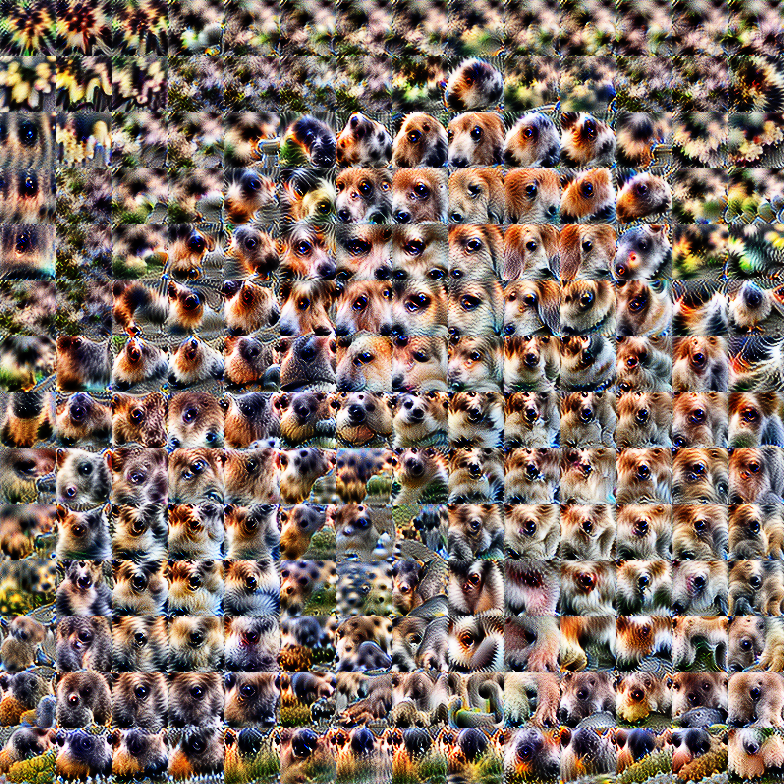

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer3', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:16:59<00:00,  4.51s/it]



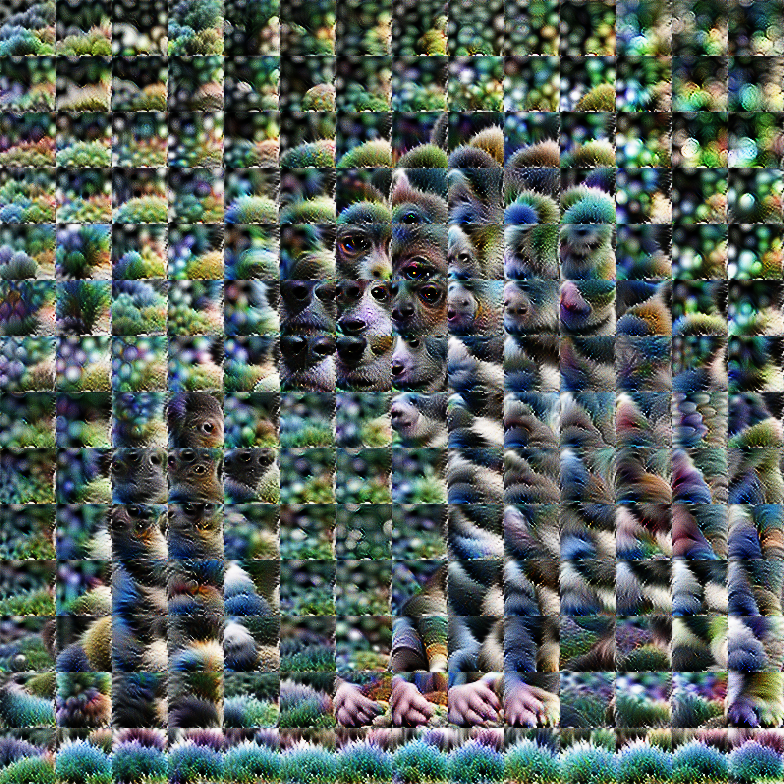

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer3', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:08:41<00:00,  4.02s/it]



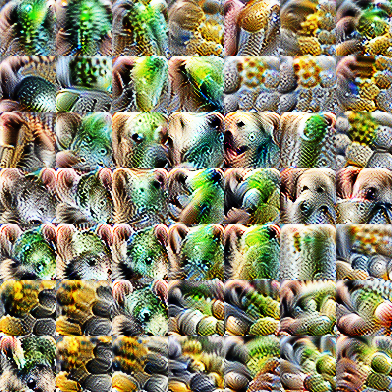

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer4', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
100%|██████████| 1024/1024 [1:09:54<00:00,  4.10s/it]



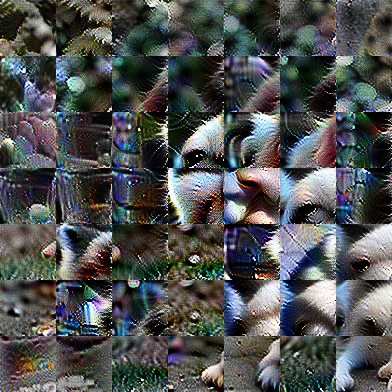

In [8]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer4', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
  0%|          | 0/1024 [00:21<?, ?it/s]


Interrupted optimization at step 1.



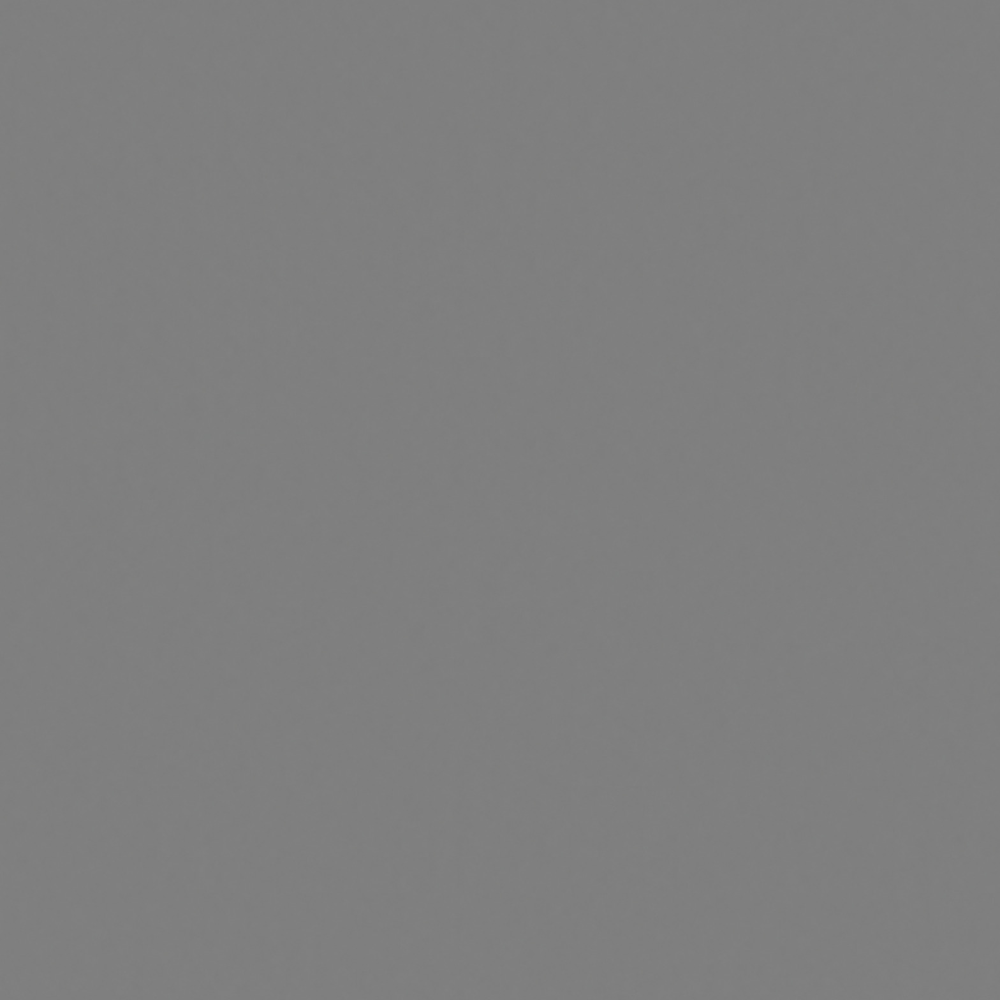

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50, 'layer2', cell_image_size=60, n_steps=1024)

/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:294: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
  0%|          | 1/1024 [00:42<12:05:01, 42.52s/it]


Interrupted optimization at step 2.



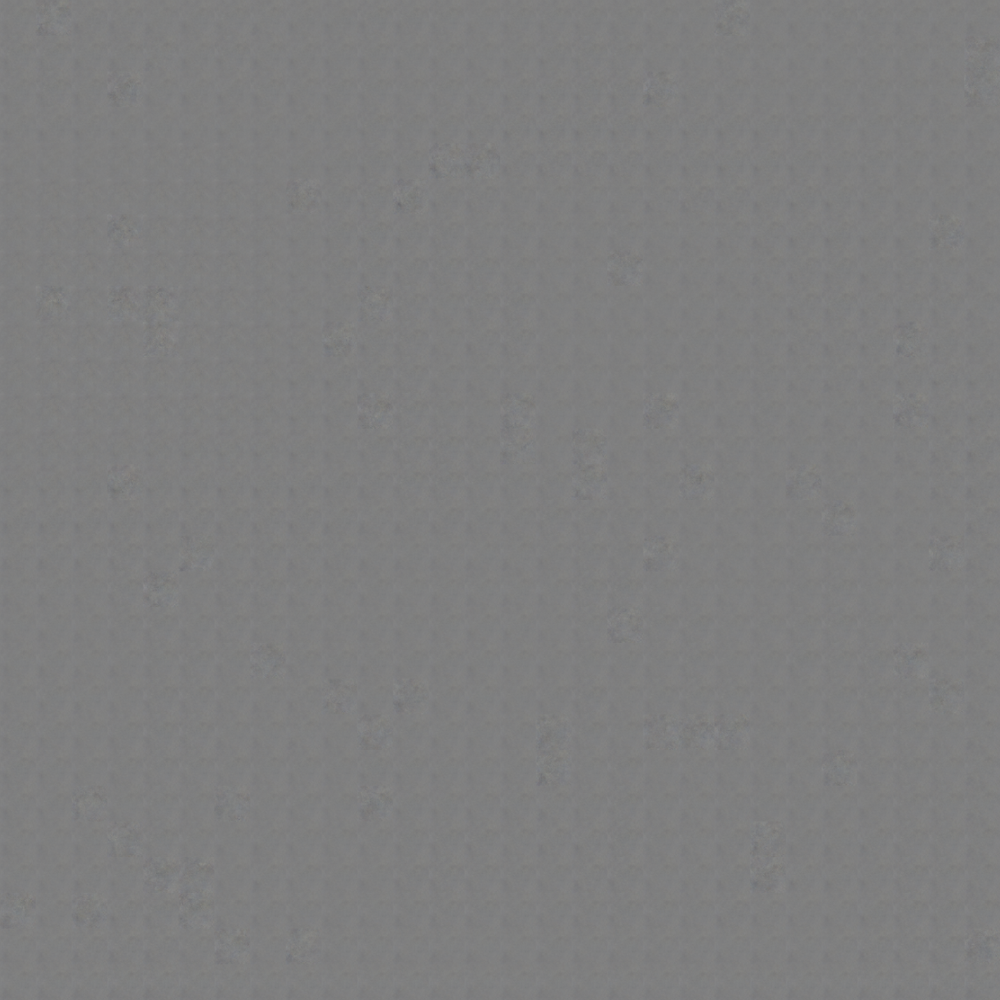

In [ ]:
_ = render_activation_grid_less_naive(img, resnet50_ss.encoder, 'layer2', cell_image_size=60, n_steps=1024)